In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import RegularGridInterpolator
from PIL import Image
import os
Image.MAX_IMAGE_PIXELS = 10000000000

## Read and test geometric maps

In [2]:
X = np.load("X.npy")
Y = np.load("Y.npy")
Z = np.load("Z.npy")
Psi = np.load("Psi.npy")

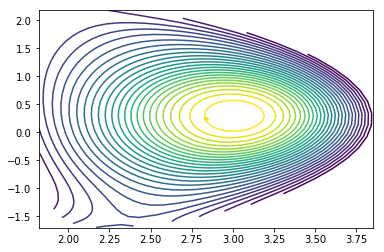

In [3]:
plt.contour(np.transpose(X[:,:,0]),np.transpose(Z[:,:,0]),np.transpose(Psi[:,:,0]),30)
plt.show()

## Create interpolating functions

In [4]:
#Grid of interpolation
r = np.linspace(0.0,1.0,num=Psi.shape[0])
theta = np.linspace(0.0,2.*np.pi,num=Psi.shape[1])
phi = np.linspace(0.0,2.*np.pi,num=Psi.shape[2])

#Interpolation
Psi_int = RegularGridInterpolator((r,theta,phi), Psi[:,:,:], method='linear', bounds_error=False, fill_value = 0)
X_int = RegularGridInterpolator((r,theta,phi), X[:,:,:], method='linear', bounds_error=False, fill_value = 0)
Y_int = RegularGridInterpolator((r,theta,phi), Y[:,:,:], method='linear', bounds_error=False, fill_value = 0)
Z_int = RegularGridInterpolator((r,theta,phi), Z[:,:,:], method='linear', bounds_error=False, fill_value = 0)

## Read connection length coordinates

In [27]:
def read_connect():
    xs = []
    ys = []
    cnc = []
    for i in range(36):
        filename = "/usr/projects/magreconn/nemato-ioannis/tests/cnc_length/short_run/cnc-poinc_t=1234.156.txt_proc%s" %str(i)
        if os.stat(filename).st_size == 0:
            pass
        else:
            file = open("/usr/projects/magreconn/nemato-ioannis/tests/cnc_length/short_run/cnc-poinc_t=1234.156.txt_proc%s" %str(i),'r')
            for columns in (raw.strip().split() for raw in file):
                xs.append(float(columns[0]))
                ys.append(float(columns[1]))
                cnc.append(float(columns[2]))
    return xs,ys,cnc

In [28]:
xs,ys,cnc = read_connect()

## Create lists of points

In [7]:
RX = X_int((xs,ys,0)).tolist()
ZX = Z_int((xs,ys,0)).tolist()

## Find points on open and closed field lines

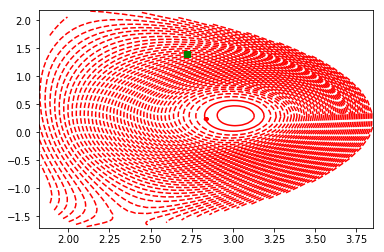

In [8]:
plt.contour(X[:,:,0],Z[:,:,0],Psi[:,:,0],60, colors='red')
plt.plot(X_int((0.6,1.5,0)),Z_int((0.6,1.5,0)),'gs')
plt.show()

In [9]:
pts = np.linspace(0,2*np.pi,30)

In [10]:
Y_int((0.3,pts,0))

array([-0.30984071, -0.3086731 , -0.30601813, -0.30203286, -0.29694577,
       -0.29103423, -0.28461061, -0.27802385, -0.27158245, -0.26556819,
       -0.26023882, -0.2558184 , -0.25244156, -0.25021986, -0.24922389,
       -0.24951193, -0.25107463, -0.2538356 , -0.2577055 , -0.26255309,
       -0.2682204 , -0.27446361, -0.28100832, -0.28755884, -0.29379899,
       -0.29937558, -0.30399195, -0.30739349, -0.30938271, -0.30984071])

## Plot on Interpolated grid

/usr/projects/hpcsoft/toss3/common/anaconda/5.0.1-python-3.6/lib/python3.6/site-packages/matplotlib/cbook/deprecation.py:106: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  warnings.warn(message, mplDeprecation, stacklevel=1)


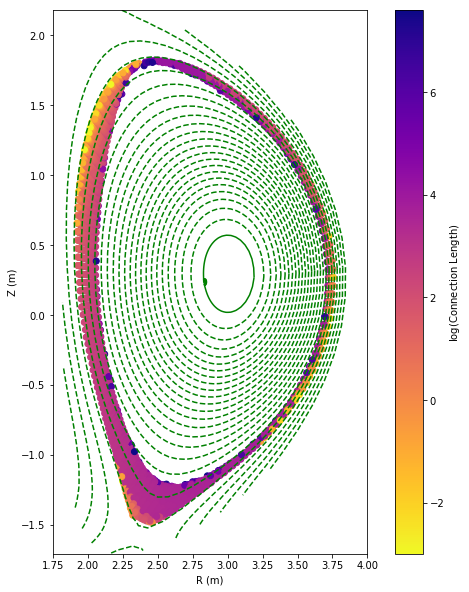

In [9]:
plt.figure(figsize=(10,10))
#cs = plt.tricontourf(xs,ys,np.log(cnc),levels=np.linspace(0,20,40),cmap='plasma_r',extend='both')
sp = plt.scatter(xs,ys,c=np.log(cnc),cmap='plasma_r')
#cs.cmap.set_over('k')
#cs.cmap.set_under('y')
plt.xlabel('R (m)')
plt.ylabel('Z (m)')
cbar = plt.colorbar(sp)
cbar.set_label(r'$\log$(Connection Length)')
plt.contour(X[:,:,0],Z[:,:,0],Psi[:,:,0],30, colors='green')
plt.xlim(1.75,4.0)
plt.axes().set_aspect('equal')
plt.show()

In [10]:
import seaborn as sns

In [29]:
cnc_short = []
cnc_long = [] 
for cnl in cnc:
    if cnl<100:
        cnc_short.append(cnl)
    else:
        cnc_long.append(cnl)

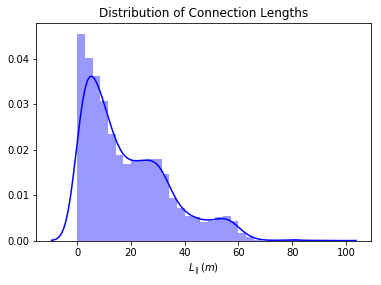

In [32]:
plt.title("Distribution of Connection Lengths")
sns.distplot(cnc_short,hist=True, kde=True, color='blue')
plt.xlabel(r"$L_{\parallel} (m)$")
#plt.xlim(0,2000)
plt.show()

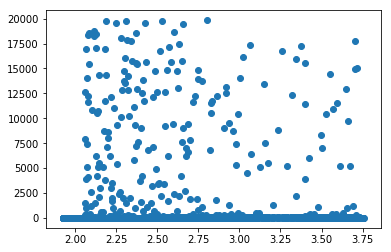

In [9]:
plt.scatter(xs,cnc)
#plt.ylim(500,1000)
plt.show()

In [8]:
len(cnc)

3569

In [27]:
Image.open("db_2d/t=1178.494.png")

In [35]:
from mpl_toolkits.mplot3d import Axes3D

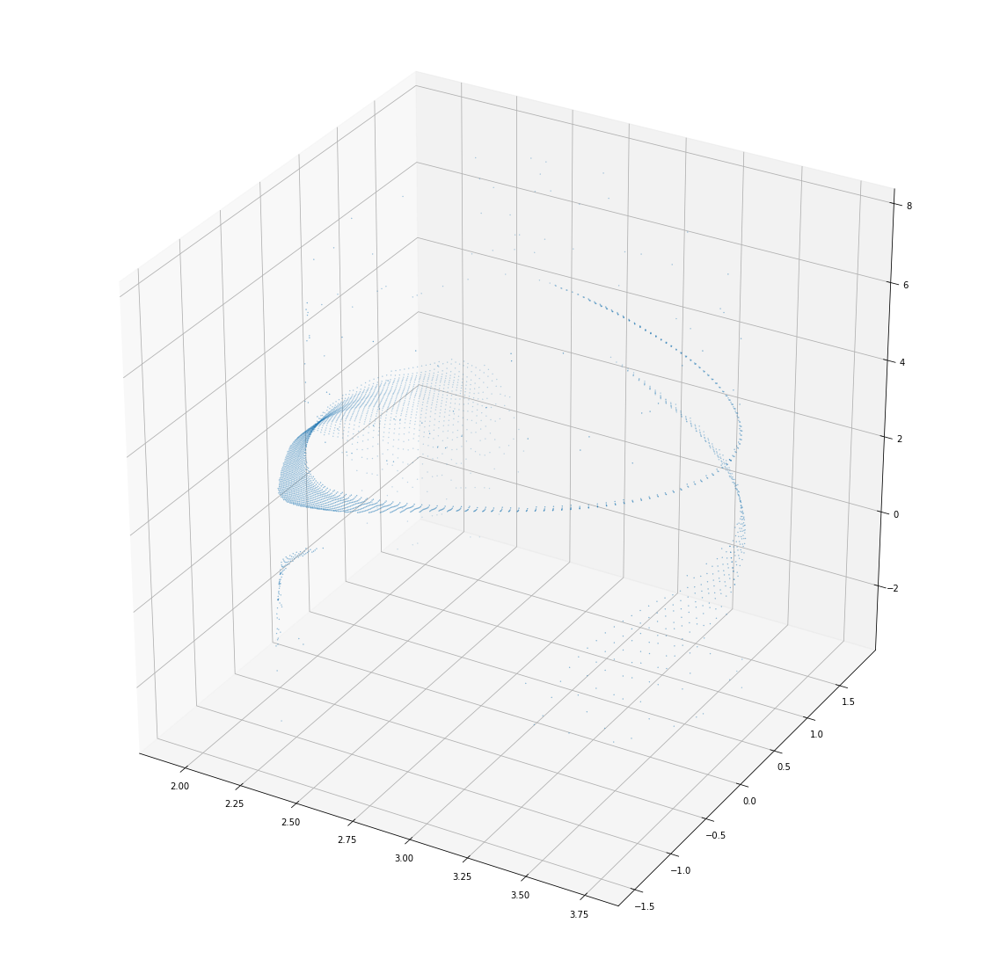

In [36]:
fig = plt.figure(figsize=(20,20))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(np.asarray(xs), np.asarray(ys),np.asarray(np.log(cnc)),s=0.1)
#plt.ylim(0,1000)
plt.show()

In [12]:
import math

In [40]:
def gridding():
    min_x = 0.0125
    max_x = 1.
    min_y = 0.0
    max_y = 6.283185308
    
    xg = np.linspace(min_x,max_x,500)
    yg = np.linspace(min_y,max_y,300)
    
    xstep = (max_x-min_x)/500
    ystep = (max_y-min_y)/300
    
    C = np.zeros((502,302))
    for l in range(len(xs)):
        i = math.floor(xs[l]/xstep)
        j = math.floor(ys[l]/ystep)
        C[i][j] = cnc[l]
    return C

In [43]:
C = gridding()

In [50]:
xg = np.linspace(min(xs),max(xs),502)
yg = np.linspace(min(ys),max(ys),302)
Y,X = np.meshgrid(yg,xg)

In [51]:
Y.shape

(502, 302)

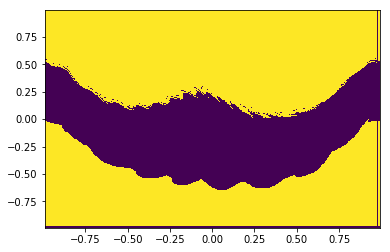

In [53]:
plt.pcolor(Y,X,C)
plt.show()